In [2]:
import xarray as xr
import geopandas as gpd
import pandas as pd
import numpy as np
import shapely.geometry
import shapely
from shapely import wkt
import rasterio
import rioxarray
from rasterio.features import shapes
from shapely.geometry import shape
import matplotlib.pyplot as plt
from pathlib import Path
import shapely.plotting
from shapely.geometry import Polygon

import shapely.wkt
import shapely.geometry

len wind =  5431
len Solar =  17006


<Axes: >

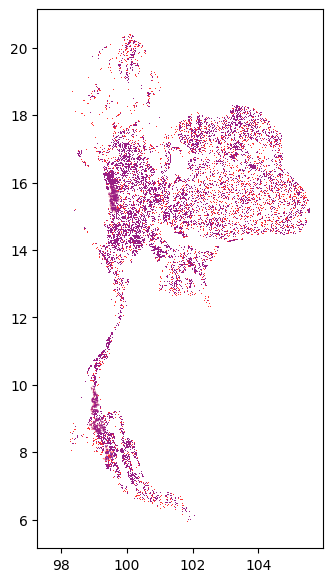

In [2]:
df_final_SI_Wind = pd.read_csv('Output_SolarWind\\df_final_SI_Wind.csv')
df_final_SI_Solar = pd.read_csv('Output_SolarWind\\df_final_SI_Solar.csv')
df_final_SI_Wind['geometry'] = df_final_SI_Wind['geometry'].apply(wkt.loads)
df_final_SI_Solar['geometry'] = df_final_SI_Solar['geometry'].apply(wkt.loads)
gdp_final_SI_Wind = gpd.GeoDataFrame(df_final_SI_Wind, crs='epsg:4326')
gdp_final_SI_Solar = gpd.GeoDataFrame(df_final_SI_Solar, crs='epsg:4326')

gdp_final_SI_Wind = gdp_final_SI_Wind.drop(columns=['raster_val','fromraster_SI_Wind'])
gdp_final_SI_Solar = gdp_final_SI_Solar.drop(columns=['raster_val','fromraster_SI_Solar'])

print("len wind = ",len(gdp_final_SI_Wind))
print("len Solar = ",len(gdp_final_SI_Solar))

fig, ax = plt.subplots(figsize=(7,7))
gdp_final_SI_Solar.geometry.plot(ax = ax, color='red',alpha = 0.8,zorder = 0)
gdp_final_SI_Wind.geometry.plot(ax = ax, color='blue',alpha = 0.4,zorder = 1)

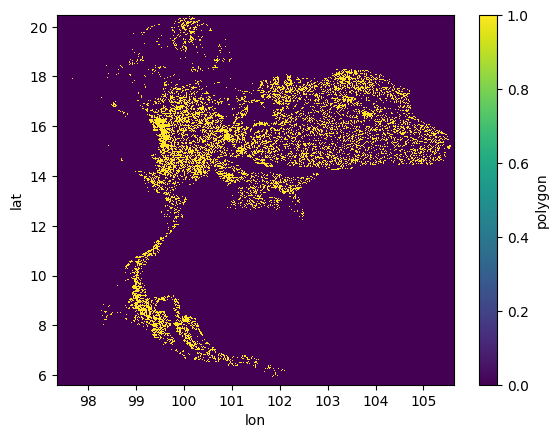

In [3]:
xr_final_SI_wind = xr.open_dataset('Output_SolarWind\\xr_final_SI_Wind.nc')
xr_final_SI_solar = xr.open_dataset('Output_SolarWind\\xr_final_SI_Solar.nc')

xr_final_SI = xr_final_SI_wind.copy()
xr_final_SI['final_SI_Solar'] = xr_final_SI_solar['final_SI_Solar']
xr_final_SI['polygon'] = 0
xr_final_SI['polygon'] = xr.where( ( (xr_final_SI_wind['final_SI_Wind'] > 0) | (xr_final_SI_solar['final_SI_Solar'] > 0) ),1,0)
xr_final_SI['polygon'].to_netcdf(path='Output_SolarWind\\xr_final_SI_combined_SolarWind.nc')

xr_final_SI['polygon'].plot()

In [4]:
mask = None
with rasterio.Env():
    with rasterio.open('Output_SolarWind\\xr_final_SI_combined_SolarWind.nc') as src:
        image = src.read(1) # first band
        results = (
        {'properties': {'raster_val': v}, 'geometry': s}
        for i, (s, v) 
        in enumerate(
            shapes(image, mask=mask, transform=src.transform)))

geoms = list(results)

gpd_polygonized_raster  = gpd.GeoDataFrame.from_features(geoms)
gpd_polygonized_raster.crs = {'init': 'epsg:4326'}
gpd_polygonized_raster= gpd_polygonized_raster.to_crs({'init': 'epsg:3857'})
gpd_polygonized_raster['area'] = gpd_polygonized_raster['geometry'].area / (10**6)
gpd_polygonized_raster['area'] = round(gpd_polygonized_raster['area'],4)
gpd_polygonized_raster = gpd_polygonized_raster.to_crs({'init': 'epsg:4326'})
gpd_polygonized_raster = gpd_polygonized_raster.loc[gpd_polygonized_raster['raster_val'] == 1]
gpd_polygonized_raster.reset_index(inplace=True,drop=True)
gpd_polygonized_raster.reset_index(inplace=True)
gpd_polygonized_raster = gpd_polygonized_raster.rename(columns = {'index' : 'pol_id'})

print(gpd_polygonized_raster)

c:\Users\EGAT\AppData\Local\Programs\Python\Python311\Lib\site-packages\pyproj\crs\crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
c:\Users\EGAT\AppData\Local\Programs\Python\Python311\Lib\site-packages\pyproj\crs\crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)


       pol_id                                           geometry  raster_val  \
0           0  POLYGON ((100.10833 20.41667, 100.11944 20.416...         1.0   
1           1  POLYGON ((99.99167 20.36944, 100.00000 20.3694...         1.0   
2           2  POLYGON ((100.10833 20.37500, 100.11111 20.375...         1.0   
3           3  POLYGON ((99.95833 20.35556, 99.96389 20.35556...         1.0   
4           4  POLYGON ((99.91667 20.33889, 99.91944 20.33889...         1.0   
...       ...                                                ...         ...   
17001   17001  POLYGON ((101.88889 5.93333, 101.88889 5.92500...         1.0   
17002   17002  POLYGON ((101.83611 5.93056, 101.83611 5.92778...         1.0   
17003   17003  POLYGON ((101.88889 5.91667, 101.88889 5.90556...         1.0   
17004   17004  POLYGON ((101.87500 5.90833, 101.87778 5.90833...         1.0   
17005   17005  POLYGON ((101.12778 5.88333, 101.13333 5.88333...         1.0   

         area  
0      8.2634  
1      

In [5]:
df_final_SI_Wind = pd.read_csv('Output_SolarWind\\df_final_SI_Wind.csv')
df_final_SI_Solar = pd.read_csv('Output_SolarWind\\df_final_SI_Solar.csv')
df_final_SI_Wind['area'] = round(df_final_SI_Wind['area'],4)
df_final_SI_Solar['area'] = round(df_final_SI_Solar['area'],4)

df_final_SI_Wind['geometry'] = df_final_SI_Wind['geometry'].apply(wkt.loads)
df_final_SI_Solar['geometry'] = df_final_SI_Solar['geometry'].apply(wkt.loads)
gdp_final_SI_Wind = gpd.GeoDataFrame(df_final_SI_Wind, crs='epsg:4326')
gdp_final_SI_Solar = gpd.GeoDataFrame(df_final_SI_Solar, crs='epsg:4326')
gdp_final_SI_Wind = gdp_final_SI_Wind.set_geometry(gdp_final_SI_Wind['geometry'])
gdp_final_SI_Solar = gdp_final_SI_Solar.set_geometry(gdp_final_SI_Solar['geometry'])

gdp_final_SI_Wind.reset_index(inplace=True,drop=True)
gdp_final_SI_Wind.reset_index(inplace=True)
gdp_final_SI_Wind = gdp_final_SI_Wind.rename(columns = {'index' : 'pol_wind_id'})

gdp_final_SI_Solar.reset_index(inplace=True,drop=True)
gdp_final_SI_Solar.reset_index(inplace=True)
gdp_final_SI_Solar = gdp_final_SI_Solar.rename(columns = {'index' : 'pol_solar_id'})

print(gdp_final_SI_Wind)
print(gdp_final_SI_Solar)

      pol_wind_id                                           geometry  \
0               0  POLYGON ((100.10833 20.41667, 100.11944 20.416...   
1               1  POLYGON ((99.99167 20.36944, 99.99444 20.36944...   
2               2  POLYGON ((99.98611 20.33611, 99.98889 20.33611...   
3               3  POLYGON ((100.03611 20.34167, 100.05000 20.341...   
4               4  POLYGON ((99.93611 20.33333, 99.93889 20.33333...   
...           ...                                                ...   
5426         5426  POLYGON ((101.90556 6.25000, 101.91111 6.25000...   
5427         5427  POLYGON ((102.11111 6.20278, 102.12500 6.20278...   
5428         5428  POLYGON ((102.06111 6.14722, 102.07222 6.14722...   
5429         5429  POLYGON ((101.90000 6.10556, 101.90278 6.10556...   
5430         5430  POLYGON ((101.90278 6.03333, 101.90556 6.03333...   

      raster_val     area                                        center  \
0              3   4.1828  POINT (100.10409891598918 20.4071

In [6]:
gpd_polygonized_raster['from_pol_wind_id'] = 0
gpd_polygonized_raster['wind_SI'] = 0
gpd_polygonized_raster['wind_area'] = 0
gpd_polygonized_raster['wind_area_coord'] = 0

gpd_polygonized_raster['from_pol_solar_id'] = 0
gpd_polygonized_raster['solar_SI'] = 0
gpd_polygonized_raster['solar_area'] = 0
gpd_polygonized_raster['solar_area_coord'] = 0

for i , pol in enumerate(gpd_polygonized_raster['geometry']):
    ##################################### WINNNDD ###########################################################################################################
    gpd_polygonized_raster['from_pol_wind_id'][i] = gdp_final_SI_Wind['pol_wind_id'].loc[gdp_final_SI_Wind['geometry'].within(pol)].count()
    if(gpd_polygonized_raster['from_pol_wind_id'][i] > 1 ):
        buffer = [poly for poly in (gdp_final_SI_Wind['geometry'].loc[gdp_final_SI_Wind['geometry'].within(pol)])]
        gpd_polygonized_raster['wind_area_coord'][i] = shapely.geometry.MultiPolygon(buffer)
        gpd_polygonized_raster['wind_SI'][i] = gdp_final_SI_Wind['Overlaid_SI_Wind'].loc[gdp_final_SI_Wind['geometry'].within(pol)].max() 
        # print("wind = ",gpd_polygonized_raster['from_pol_wind_id'][i],gpd_polygonized_raster['wind_area_coord'][i])
    else:
        if(gpd_polygonized_raster['from_pol_wind_id'][i] == 1 ):
            buffer = gdp_final_SI_Wind['geometry'].loc[gdp_final_SI_Wind['geometry'].within(pol)]
            buffer = buffer.reset_index()
            gpd_polygonized_raster['wind_area_coord'][i] = buffer['geometry'][0]
            gpd_polygonized_raster['wind_SI'][i] = gdp_final_SI_Wind['Overlaid_SI_Wind'].loc[gdp_final_SI_Wind['geometry'].within(pol)].max() 
        else:
            gpd_polygonized_raster['from_pol_wind_id'][i] = 0
            gpd_polygonized_raster['wind_area_coord'][i] = None
            gpd_polygonized_raster['wind_SI'][i] = 0
    gpd_polygonized_raster['wind_area'][i] = (gdp_final_SI_Wind['area'].loc[gdp_final_SI_Wind['geometry'].within(pol)]).sum()
    ##################################### WINNNDD ###########################################################################################################

    ##################################### Solar ###########################################################################################################
    gpd_polygonized_raster['from_pol_solar_id'][i] = gdp_final_SI_Solar['pol_solar_id'].loc[gdp_final_SI_Solar['geometry'].within(pol)].count()
    if(gpd_polygonized_raster['from_pol_solar_id'][i] > 1 ):
        buffer = [poly for poly in (gdp_final_SI_Solar['geometry'].loc[gdp_final_SI_Solar['geometry'].within(pol)])]
        gpd_polygonized_raster['solar_area_coord'][i] = shapely.geometry.MultiPolygon(buffer)
        gpd_polygonized_raster['solar_SI'][i] = gdp_final_SI_Solar['Overlaid_SI_Solar'].loc[gdp_final_SI_Solar['geometry'].within(pol)].max()   
        # print("solar = ",gpd_polygonized_raster['from_pol_solar_id'][i],gpd_polygonized_raster['solar_area_coord'][i])
    else:
        if(gpd_polygonized_raster['from_pol_solar_id'][i] == 1 ):
            buffer = gdp_final_SI_Solar['geometry'].loc[gdp_final_SI_Solar['geometry'].within(pol)]
            buffer = buffer.reset_index()
            gpd_polygonized_raster['solar_area_coord'][i] = buffer['geometry'][0]
            gpd_polygonized_raster['solar_SI'][i] = gdp_final_SI_Solar['Overlaid_SI_Solar'].loc[gdp_final_SI_Solar['geometry'].within(pol)].max()
        else:
            gpd_polygonized_raster['from_pol_solar_id'][i] = 0
            gpd_polygonized_raster['solar_area_coord'][i] = None
            gpd_polygonized_raster['solar_SI'][i] = 0
    gpd_polygonized_raster['solar_area'][i] = (gdp_final_SI_Solar['area'].loc[gdp_final_SI_Solar['geometry'].within(pol)]).sum()
    ##################################### Solar ###########################################################################################################
    
try:
    gpd_polygonized_raster = gpd_polygonized_raster.drop(columns='raster_val')
except:
    None
print(gpd_polygonized_raster)
gpd_polygonized_raster.to_csv('Output_SolarWind\\df_final_SI_combined_SolarWind.csv',index=False)

C:\Users\EGAT\AppData\Local\Temp\ipykernel_29464\1725815188.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  gpd_polygonized_raster['from_pol_wind_id'][i] = gdp_final_SI_Wind['pol_wind_id'].loc[gdp_final_SI_Wind['geometry'].within(pol)].count()
C:\Users\EGAT\AppData\Local\Temp\ipykernel_29464\1725815188.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  gpd_polygonized_raster['wind_area_coord'][i] = buffer['geometry'][0]
C:\Users\EGAT\AppData\Local\Temp\ipykernel_29464\1725815188.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation

       pol_id                                           geometry    area  \
0           0  POLYGON ((100.10833 20.41667, 100.11944 20.416...  8.2634   
1           1  POLYGON ((99.99167 20.36944, 100.00000 20.3694...  6.1192   
2           2  POLYGON ((100.10833 20.37500, 100.11111 20.375...  2.7537   
3           3  POLYGON ((99.95833 20.35556, 99.96389 20.35556...  3.1614   
4           4  POLYGON ((99.91667 20.33889, 99.91944 20.33889...  3.0591   
...       ...                                                ...     ...   
17001   17001  POLYGON ((101.88889 5.93333, 101.88889 5.92500...  0.9613   
17002   17002  POLYGON ((101.83611 5.93056, 101.83611 5.92778...  2.5955   
17003   17003  POLYGON ((101.88889 5.91667, 101.88889 5.90556...  0.6729   
17004   17004  POLYGON ((101.87500 5.90833, 101.87778 5.90833...  1.6342   
17005   17005  POLYGON ((101.12778 5.88333, 101.13333 5.88333...  0.4806   

       from_pol_wind_id   wind_SI  wind_area  \
0                     1  1.817748     4

In [7]:
region = pd.read_csv('Data\\Region.csv',index_col=False)
thailandmap = gpd.read_file('Data\\tha_admbnda_adm1_rtsd_20220121\\tha_admbnda_adm1_rtsd_20220121.shp')

thailandmap.crs = {'init': 'epsg:4326'}
list_region = []

count = 0
for i in thailandmap['ADM1_TH']:
    r = region['region'].loc[region['province'] == i]
    try : 
        # print(i,r.values[0])
        list_region.append(r.values[0])
    except :
        print(i,'xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx')
        list_region.append('xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx')       
    
thailandmap['region'] = list_region

gpd_polygonized_raster['region'] = 'unk'

for i, pol in enumerate(thailandmap['ADM1_TH']):
    gpd_polygonized_raster['region'].loc[gpd_polygonized_raster['geometry'].within(thailandmap['geometry'][i])] = thailandmap['region'][i]

print(gpd_polygonized_raster)
gpd_polygonized_raster.to_csv('Output_SolarWind\\df_final_SI_combined_SolarWind.csv',index=False)

c:\Users\EGAT\AppData\Local\Programs\Python\Python311\Lib\site-packages\pyproj\crs\crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\EGAT\AppData\Local\Temp\ipykernel_29464\3806746431.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  gpd_polygonized_raster['region'].loc[gpd_polygonized_raster['geometry'].within(thailandmap['geometry'][i])] = thailandmap['region'][i]


       pol_id                                           geometry    area  \
0           0  POLYGON ((100.10833 20.41667, 100.11944 20.416...  8.2634   
1           1  POLYGON ((99.99167 20.36944, 100.00000 20.3694...  6.1192   
2           2  POLYGON ((100.10833 20.37500, 100.11111 20.375...  2.7537   
3           3  POLYGON ((99.95833 20.35556, 99.96389 20.35556...  3.1614   
4           4  POLYGON ((99.91667 20.33889, 99.91944 20.33889...  3.0591   
...       ...                                                ...     ...   
17001   17001  POLYGON ((101.88889 5.93333, 101.88889 5.92500...  0.9613   
17002   17002  POLYGON ((101.83611 5.93056, 101.83611 5.92778...  2.5955   
17003   17003  POLYGON ((101.88889 5.91667, 101.88889 5.90556...  0.6729   
17004   17004  POLYGON ((101.87500 5.90833, 101.87778 5.90833...  1.6342   
17005   17005  POLYGON ((101.12778 5.88333, 101.13333 5.88333...  0.4806   

       from_pol_wind_id   wind_SI  wind_area  \
0                     1  1.817748     4

In [8]:
gpd_polygonized_raster_2 = gpd.sjoin_nearest(gpd_polygonized_raster,thailandmap,how='left')
print(gpd_polygonized_raster_2)

c:\Users\EGAT\AppData\Local\Programs\Python\Python311\Lib\site-packages\geopandas\array.py:364: UserWarning: Geometry is in a geographic CRS. Results from 'sjoin_nearest' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  warnings.warn(


       pol_id                                           geometry    area  \
0           0  POLYGON ((100.10833 20.41667, 100.11944 20.416...  8.2634   
1           1  POLYGON ((99.99167 20.36944, 100.00000 20.3694...  6.1192   
2           2  POLYGON ((100.10833 20.37500, 100.11111 20.375...  2.7537   
3           3  POLYGON ((99.95833 20.35556, 99.96389 20.35556...  3.1614   
4           4  POLYGON ((99.91667 20.33889, 99.91944 20.33889...  3.0591   
...       ...                                                ...     ...   
17001   17001  POLYGON ((101.88889 5.93333, 101.88889 5.92500...  0.9613   
17002   17002  POLYGON ((101.83611 5.93056, 101.83611 5.92778...  2.5955   
17003   17003  POLYGON ((101.88889 5.91667, 101.88889 5.90556...  0.6729   
17004   17004  POLYGON ((101.87500 5.90833, 101.87778 5.90833...  1.6342   
17005   17005  POLYGON ((101.12778 5.88333, 101.13333 5.88333...  0.4806   

       from_pol_wind_id   wind_SI  wind_area  \
0                     1  1.817748     4

In [9]:
print(gpd_polygonized_raster_2.columns)
gpd_polygonized_raster_2 = gpd_polygonized_raster_2.drop(columns=
                                                         ['index_right'
                                                          ,'Shape_Leng'
                                                          ,'Shape_Area'
                                                          ,'ADM1ALT2EN'
                                                          ,'ADM1_PCODE'
                                                          ,'ADM1_REF'
                                                          ,'ADM1ALT1EN'
                                                          ,'ADM1ALT2EN'
                                                          ,'ADM1ALT1TH'
                                                          ,'ADM1ALT2EN'
                                                          ,'ADM1ALT1TH'
                                                          ,'ADM1ALT2TH'
                                                          ,'ADM0_EN'
                                                          ,'ADM0_TH'
                                                          ,'ADM0_PCODE'
                                                          ,'date'
                                                          ,'validOn'
                                                          ,'validTo'
                                                          ])
print(gpd_polygonized_raster_2.columns)

Index(['pol_id', 'geometry', 'area', 'from_pol_wind_id', 'wind_SI',
       'wind_area', 'wind_area_coord', 'from_pol_solar_id', 'solar_SI',
       'solar_area', 'solar_area_coord', 'region_left', 'index_right',
       'Shape_Leng', 'Shape_Area', 'ADM1_EN', 'ADM1_TH', 'ADM1_PCODE',
       'ADM1_REF', 'ADM1ALT1EN', 'ADM1ALT2EN', 'ADM1ALT1TH', 'ADM1ALT2TH',
       'ADM0_EN', 'ADM0_TH', 'ADM0_PCODE', 'date', 'validOn', 'validTo',
       'region_right'],
      dtype='object')
Index(['pol_id', 'geometry', 'area', 'from_pol_wind_id', 'wind_SI',
       'wind_area', 'wind_area_coord', 'from_pol_solar_id', 'solar_SI',
       'solar_area', 'solar_area_coord', 'region_left', 'ADM1_EN', 'ADM1_TH',
       'region_right'],
      dtype='object')


In [10]:
gpd_polygonized_raster_2 = gpd_polygonized_raster_2.drop(columns = 'region_left')
gpd_polygonized_raster_2 = gpd_polygonized_raster_2.rename(columns= {'region_right':'region'})
gpd_polygonized_raster_2 = gpd_polygonized_raster_2.drop_duplicates('pol_id')
print(gpd_polygonized_raster_2)

       pol_id                                           geometry    area  \
0           0  POLYGON ((100.10833 20.41667, 100.11944 20.416...  8.2634   
1           1  POLYGON ((99.99167 20.36944, 100.00000 20.3694...  6.1192   
2           2  POLYGON ((100.10833 20.37500, 100.11111 20.375...  2.7537   
3           3  POLYGON ((99.95833 20.35556, 99.96389 20.35556...  3.1614   
4           4  POLYGON ((99.91667 20.33889, 99.91944 20.33889...  3.0591   
...       ...                                                ...     ...   
17001   17001  POLYGON ((101.88889 5.93333, 101.88889 5.92500...  0.9613   
17002   17002  POLYGON ((101.83611 5.93056, 101.83611 5.92778...  2.5955   
17003   17003  POLYGON ((101.88889 5.91667, 101.88889 5.90556...  0.6729   
17004   17004  POLYGON ((101.87500 5.90833, 101.87778 5.90833...  1.6342   
17005   17005  POLYGON ((101.12778 5.88333, 101.13333 5.88333...  0.4806   

       from_pol_wind_id   wind_SI  wind_area  \
0                     1  1.817748     4

In [11]:
gpd_polygonized_raster_2.to_csv('Output_SolarWind\\df_final_SI_combined_SolarWind.csv',index=False)

In [12]:
df = pd.read_csv('Output_SolarWind\\df_final_SI_combined_SolarWind.csv')
df = df.drop(columns=[
    'geometry',
    'from_pol_wind_id',
    'wind_area_coord',
    'from_pol_solar_id'
    ,'solar_area_coord',
    'ADM1_EN',
    'ADM1_TH'
    ])

In [13]:
df = df.drop_duplicates('pol_id')
print(df)

       pol_id    area   wind_SI  wind_area  solar_SI  solar_area region
0           0  8.2634  1.817748     4.1828  2.060396      8.2634     R4
1           1  6.1192  1.871226     5.0993  2.214612      6.1192     R4
2           2  2.7537  0.000000     0.0000  2.145304      2.7537     R4
3           3  3.1614  0.000000     0.0000  2.218820      3.1614     R4
4           4  3.0591  0.000000     0.0000  2.223646      3.0591     R4
...       ...     ...       ...        ...       ...         ...    ...
17001   17001  0.9613  0.000000     0.0000  2.528544      0.9613     R3
17002   17002  2.5955  0.000000     0.0000  2.303855      2.5955     R3
17003   17003  0.6729  0.000000     0.0000  2.452401      0.6729     R3
17004   17004  1.6342  0.000000     0.0000  2.329302      1.6342     R3
17005   17005  0.4806  0.000000     0.0000  1.802071      0.4806     R3

[17006 rows x 7 columns]


In [14]:
df = df.reset_index(drop=True)
print(df)

       pol_id    area   wind_SI  wind_area  solar_SI  solar_area region
0           0  8.2634  1.817748     4.1828  2.060396      8.2634     R4
1           1  6.1192  1.871226     5.0993  2.214612      6.1192     R4
2           2  2.7537  0.000000     0.0000  2.145304      2.7537     R4
3           3  3.1614  0.000000     0.0000  2.218820      3.1614     R4
4           4  3.0591  0.000000     0.0000  2.223646      3.0591     R4
...       ...     ...       ...        ...       ...         ...    ...
17001   17001  0.9613  0.000000     0.0000  2.528544      0.9613     R3
17002   17002  2.5955  0.000000     0.0000  2.303855      2.5955     R3
17003   17003  0.6729  0.000000     0.0000  2.452401      0.6729     R3
17004   17004  1.6342  0.000000     0.0000  2.329302      1.6342     R3
17005   17005  0.4806  0.000000     0.0000  1.802071      0.4806     R3

[17006 rows x 7 columns]


In [15]:
try:
    df = df.set_index('pol_id')
except:
    None

try:
    xr = xr.Dataset.from_dataframe(df)
except:
    None

xr.to_netcdf(path='Output_SolarWind\\xr_final_SI_combined_SolarWind.nc')
print(xr)

<xarray.Dataset>
Dimensions:     (pol_id: 17006)
Coordinates:
  * pol_id      (pol_id) int64 0 1 2 3 4 5 ... 17001 17002 17003 17004 17005
Data variables:
    area        (pol_id) float64 8.263 6.119 2.754 3.161 ... 0.6729 1.634 0.4806
    wind_SI     (pol_id) float64 1.818 1.871 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0 0.0
    wind_area   (pol_id) float64 4.183 5.099 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0 0.0
    solar_SI    (pol_id) float64 2.06 2.215 2.145 2.219 ... 2.452 2.329 1.802
    solar_area  (pol_id) float64 8.263 6.119 2.754 3.161 ... 0.6729 1.634 0.4806
    region      (pol_id) object 'R4' 'R4' 'R4' 'R4' 'R4' ... 'R3' 'R3' 'R3' 'R3'


In [9]:
#์next ,  I exclude poly gon where existing power plants are located

df_ref = pd.read_csv('Output_SolarWind\\df_final_SI_combined_SolarWind.csv')
df_ref = df_ref.drop_duplicates('pol_id')
df_ref = df_ref.loc[df_ref['wind_SI']>0]
df_ref = df_ref.loc[df_ref['solar_SI']>0]
df_ref.reset_index(inplace=True,drop=True)
df_ref['geometry'] = df_ref['geometry'].apply(wkt.loads)
df_ref = gpd.GeoDataFrame(df_ref, crs='epsg:4326')
df_ref = df_ref.set_geometry(df_ref['geometry'])
df_ref.crs = {'init': 'epsg:4326'}
print('len before = ',len(df_ref))

existingplants = pd.read_csv("Data\\ExistingPlants_wPosition.csv")
existingplants = gpd.GeoDataFrame(existingplants, geometry =gpd.points_from_xy(existingplants['longitude'],existingplants['latitude']))
existingplants.crs = {'init': 'epsg:4326'}
# existingplants = existingplants.loc[existingplants['EXP_MW'] >= 1]
existingplants.reset_index(inplace=True,drop=True)
        
for i in existingplants.columns:
    if i not in ['Sale_MW','FuelTypeName','latitude','longitude','geometry']:
        existingplants = existingplants.drop(columns=i)

df_existingplants = gpd.sjoin_nearest(existingplants,df_ref,how='left')

df_existingplants = df_existingplants.drop_duplicates('pol_id')

df_ref = pd.read_csv('Output_SolarWind\\df_final_SI_combined_SolarWind.csv')
df_ref = df_ref.drop_duplicates('pol_id')
df_ref.reset_index(inplace=True,drop=True)
df_ref['geometry'] = df_ref['geometry'].apply(wkt.loads)
df_ref = gpd.GeoDataFrame(df_ref, crs='epsg:4326')
df_ref = df_ref.set_geometry(df_ref['geometry'])
df_ref.crs = {'init': 'epsg:4326'}

df_ref['contain_exs'] = 0

for i , pol in enumerate(df_ref['geometry']):
    if (df_existingplants['Sale_MW'].loc[df_existingplants['pol_id'] == df_ref['pol_id'][i]].count() > 0):
        df_ref['contain_exs'][i] = 1
    else :
        df_ref['contain_exs'][i] = 0
        
df_ref = df_ref.loc[df_ref['contain_exs'] == 0]
df_ref = df_ref.drop_duplicates('pol_id')
df_ref.reset_index(inplace=True,drop=True)
print('len after = ',len(df_ref))

c:\Users\EGAT\AppData\Local\Programs\Python\Python311\Lib\site-packages\pyproj\crs\crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
c:\Users\EGAT\AppData\Local\Programs\Python\Python311\Lib\site-packages\pyproj\crs\crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
c:\Users\EGAT\AppData\Local\Programs\Python\Python311\Lib\site-packages\geopandas\array.py:364: UserWarning: Geometry is in a geographic CRS. Results from 'sjoin_

len before =  5334


c:\Users\EGAT\AppData\Local\Programs\Python\Python311\Lib\site-packages\pyproj\crs\crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\EGAT\AppData\Local\Temp\ipykernel_29724\3504679556.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_ref['contain_exs'][i] = 0
C:\Users\EGAT\AppData\Local\Temp\ipykernel_29724\3504679556.py:40: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

len after =  16420


In [10]:
REbiglot = pd.read_excel('Data\\NewVRE.xlsx',sheet_name='สรุปผู้ที่ได้รับการคัดเลือก')
REbiglot = gpd.GeoDataFrame(REbiglot, geometry =gpd.points_from_xy(REbiglot['lon'],REbiglot['lat']))
REbiglot.crs = {'init': 'epsg:4326'}
REbiglot.reset_index(inplace=True,drop=True)

df_REbiglot = gpd.sjoin_nearest(REbiglot,df_ref,how='left')
df_REbiglot = df_REbiglot.drop_duplicates('pol_id')

print(df_REbiglot.columns)

for i , pol in enumerate(df_ref['geometry']):
    if (df_REbiglot['MW'].loc[df_REbiglot['pol_id'] == df_ref['pol_id'][i]].count() > 0):
        df_ref['contain_exs'][i] = 1
    else :
        df_ref['contain_exs'][i] = 0

print('len before = ',len(df_ref))
df_ref = df_ref.loc[df_ref['contain_exs'] == 0]
df_ref.reset_index(inplace=True,drop=True)
df_ref = df_ref.drop_duplicates('pol_id')
df_ref = df_ref.reset_index()
print('len after = ',len(df_ref))

c:\Users\EGAT\AppData\Local\Programs\Python\Python311\Lib\site-packages\pyproj\crs\crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
c:\Users\EGAT\AppData\Local\Programs\Python\Python311\Lib\site-packages\geopandas\array.py:364: UserWarning: Geometry is in a geographic CRS. Results from 'sjoin_nearest' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  warnings.warn(
C:\Users\EGAT\AppData\Local\Temp\ipykernel_29724\1785729941.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a

Index(['id', 'owner', 'planttype', 'planttype2', 'MW', 'lat', 'lon',
       'geometry', 'index_right', 'pol_id', 'area', 'from_pol_wind_id',
       'wind_SI', 'wind_area', 'wind_area_coord', 'from_pol_solar_id',
       'solar_SI', 'solar_area', 'solar_area_coord', 'ADM1_EN', 'ADM1_TH',
       'region', 'contain_exs'],
      dtype='object')
len before =  16420
len after =  16264


In [11]:
df_ref.to_csv('Output_SolarWind\\df_final_SI_combined_SolarWind_exc.csv',index=False)

In [12]:
df_ref = df_ref.drop(columns=[
    'geometry',
    'from_pol_wind_id',
    'wind_area_coord',
    'from_pol_solar_id',
    'solar_area_coord',
    'ADM1_EN',
    'ADM1_TH',
    'contain_exs'
    ])

df_ref = df_ref.set_index('index')

print(df_ref)

       pol_id    area   wind_SI  wind_area  solar_SI  solar_area region
index                                                                  
0           0  8.2634  1.817748     4.1828  2.060396      8.2634     R4
1           1  6.1192  1.871226     5.0993  2.214612      6.1192     R4
2           2  2.7537  0.000000     0.0000  2.145304      2.7537     R4
3           3  3.1614  0.000000     0.0000  2.218820      3.1614     R4
4           4  3.0591  0.000000     0.0000  2.223646      3.0591     R4
...       ...     ...       ...        ...       ...         ...    ...
16259   17001  0.9613  0.000000     0.0000  2.528544      0.9613     R3
16260   17002  2.5955  0.000000     0.0000  2.303855      2.5955     R3
16261   17003  0.6729  0.000000     0.0000  2.452401      0.6729     R3
16262   17004  1.6342  0.000000     0.0000  2.329302      1.6342     R3
16263   17005  0.4806  0.000000     0.0000  1.802071      0.4806     R3

[16264 rows x 7 columns]


In [13]:
import xarray as xr
try:
    xr2 = xr.Dataset.from_dataframe(df_ref)
except:
    None

xr2.to_netcdf(path='Output_SolarWind\\xr_final_SI_combined_SolarWind_exc.nc')

print(xr2)

<xarray.Dataset>
Dimensions:     (index: 16264)
Coordinates:
  * index       (index) int64 0 1 2 3 4 5 ... 16259 16260 16261 16262 16263
Data variables:
    pol_id      (index) int64 0 1 2 3 4 5 ... 17001 17002 17003 17004 17005
    area        (index) float64 8.263 6.119 2.754 3.161 ... 0.6729 1.634 0.4806
    wind_SI     (index) float64 1.818 1.871 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0 0.0
    wind_area   (index) float64 4.183 5.099 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0 0.0
    solar_SI    (index) float64 2.06 2.215 2.145 2.219 ... 2.452 2.329 1.802
    solar_area  (index) float64 8.263 6.119 2.754 3.161 ... 0.6729 1.634 0.4806
    region      (index) object 'R4' 'R4' 'R4' 'R4' 'R4' ... 'R3' 'R3' 'R3' 'R3'
